In [1]:
# Importing Necessary Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
# Importing Dataset
df = pd.read_csv("salary.csv")
pd.set_option("display.max_columns", None) 
df.head(1)

C:\Users\kesha\AppData\Local\Temp\ipykernel_36336\3210461817.py:2: DtypeWarning: Columns (16,18,20) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("salary.csv")


,AGENCY,AGENCY NAME,LAST NAME,FIRST NAME,MI,CLASS CODE,CLASS TITLE,ETHNICITY,GENDER,STATUS,EMPLOY DATE,HRLY RATE,HRS PER WK,MONTHLY,ANNUAL,STATE NUMBER,duplicated,multiple_full_time_jobs,combined_multiple_jobs,summed_annual_salary,hide_from_search
0,241,"COMPTROLLER OF PUBLIC ACCOUNTS, JUDICIARY SECT...",RUCKER,MORTON,V,JD25,"JUDGE, RETIRED ...",WHITE,MALE,URP - UNCLASSIFIED REGULAR PART-TIME,02/18/88,75.9615,29.0,9545.82,114549.84,127717,True,NaN,NaN,131407.08,NaN


In [3]:
# There is a warning while loading the dataset this is due to the dataset cotains mixed data types to overcome this
# Loading the dataset with low_memory set to False
df = pd.read_csv("salary.csv", low_memory=False)
df.head()

,AGENCY,AGENCY NAME,LAST NAME,FIRST NAME,MI,CLASS CODE,CLASS TITLE,ETHNICITY,GENDER,STATUS,EMPLOY DATE,HRLY RATE,HRS PER WK,MONTHLY,ANNUAL,STATE NUMBER,duplicated,multiple_full_time_jobs,combined_multiple_jobs,summed_annual_salary,hide_from_search
0,241,"COMPTROLLER OF PUBLIC ACCOUNTS, JUDICIARY SECT...",RUCKER,MORTON,V,JD25,"JUDGE, RETIRED ...",WHITE,MALE,URP - UNCLASSIFIED REGULAR PART-TIME,02/18/88,75.96150,29.0,9545.82,114549.84,127717,True,NaN,NaN,131407.08,NaN
1,212,OFFICE OF COURT ADMINISTRATION ...,RUCKER,MORTON,V,3524,GENERAL COUNSEL IV ...,WHITE,MALE,CTP - CLASSIFIED TEMPORARY PART-TIME,02/01/15,81.04454,4.0,1404.77,16857.24,127717,True,NaN,NaN,NaN,True
2,241,"COMPTROLLER OF PUBLIC ACCOUNTS, JUDICIARY SECT...",SPECIA JR,JOHN,J,JD25,"JUDGE, RETIRED ...",WHITE,MALE,URP - UNCLASSIFIED REGULAR PART-TIME,02/01/20,75.96150,29.0,9545.82,114549.84,59115,True,NaN,NaN,131407.08,NaN
3,212,OFFICE OF COURT ADMINISTRATION ...,SPECIA JR,JOHN,J,3524,GENERAL COUNSEL IV ...,WHITE,MALE,CTP - CLASSIFIED TEMPORARY PART-TIME,09/01/18,81.04453,4.0,1404.77,16857.24,59115,True,NaN,NaN,NaN,True
4,696,TEXAS DEPARTMENT OF CRIMINAL JUSTICE ...,ONTIVEROS,ESTHER,,4504,CORREC OFFICER IV ...,HISPANIC,FEMALE,CRF - CLASSIFIED REGULAR FULL-TIME,06/29/20,0.00000,40.0,3284.27,39411.24,165030,True,1.0,NaN,NaN,NaN


# 1) Basic Checks and data filtering

In [5]:
df.shape

(149481, 21)

#### There are 21 features present in the dataset with each having 149481 entries.
####

In [7]:
# Checking for the duplicates 
df.duplicated().sum

<bound method Series.sum of 0         False
1         False
2         False
3         False
4         False
          ...  
149476    False
149477    False
149478    False
149479    False
149480    False
Length: 149481, dtype: bool>

#### No actual duplicates present in the data.
####

In [9]:
# Now let's check for the column 'duplicated'.
# Checking for unique entries in the 'duplicated' column.
print(df['duplicated'].unique())
# Checking the occurence of the unique values.
print(df['duplicated'].value_counts())

[True nan]
duplicated
True    143
Name: count, dtype: int64


In [10]:
# Checking for unique entries in 'multiple_full_time_jobs' column.
print(df['multiple_full_time_jobs'].unique())
# Checking the occurence of the unique values.
print(df['multiple_full_time_jobs'].value_counts())

[nan  1.]
multiple_full_time_jobs
1.0    14
Name: count, dtype: int64


In [11]:
# Checking for unique entries in 'combined_multiple_jobs' column.
print(df['combined_multiple_jobs'].unique())
# Checking for the occurence of unique values.
print(df['combined_multiple_jobs'].value_counts())

[nan True]
combined_multiple_jobs
True    97
Name: count, dtype: int64


In [12]:
# Checking for unique entries in 'summed_annual_salary' column.
print(df['summed_annual_salary'].nunique())
# Checking for the occurence of unique values.
print(df['summed_annual_salary'].value_counts())

15
summed_annual_salary
131407.08    2
171383.40    1
31950.00     1
33300.00     1
33966.00     1
39174.00     1
35570.52     1
56952.60     1
21839.76     1
121200.00    1
90000.00     1
150000.00    1
92400.00     1
18000.00     1
30312.84     1
Name: count, dtype: int64


In [13]:
# Checking for unique entries in 'hide_from_search' column.
print(df['hide_from_search'].nunique())
# Checking for the occurence of unique values.
print(df['hide_from_search'].value_counts())

1
hide_from_search
True    16
Name: count, dtype: int64


### Interpretation:
#### "The columns 'is_duplicated', 'multiple_full_time_jobs', 'combined_multiple_jobs', 'summed_annual_salary', and 'hide_from_search' do not contribute much to the dataset because most of their values are 'NaN'. Therefore, we will remove these columns
####

In [15]:
# Removing the unnecessary columns.
columns_to_remove = ['duplicated',  'multiple_full_time_jobs', 'combined_multiple_jobs', 
                     'summed_annual_salary', 'hide_from_search']
df = df.drop(columns=columns_to_remove)
df.head(2)

,AGENCY,AGENCY NAME,LAST NAME,FIRST NAME,MI,CLASS CODE,CLASS TITLE,ETHNICITY,GENDER,STATUS,EMPLOY DATE,HRLY RATE,HRS PER WK,MONTHLY,ANNUAL,STATE NUMBER
0,241,"COMPTROLLER OF PUBLIC ACCOUNTS, JUDICIARY SECT...",RUCKER,MORTON,V,JD25,"JUDGE, RETIRED ...",WHITE,MALE,URP - UNCLASSIFIED REGULAR PART-TIME,02/18/88,75.96150,29.0,9545.82,114549.84,127717
1,212,OFFICE OF COURT ADMINISTRATION ...,RUCKER,MORTON,V,3524,GENERAL COUNSEL IV ...,WHITE,MALE,CTP - CLASSIFIED TEMPORARY PART-TIME,02/01/15,81.04454,4.0,1404.77,16857.24,127717


In [16]:
# Checking the data types
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 149481 entries, 0 to 149480
Data columns (total 16 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   AGENCY        149481 non-null  int64  
 1   AGENCY NAME   149481 non-null  object 
 2   LAST NAME     149481 non-null  object 
 3   FIRST NAME    149481 non-null  object 
 4   MI            149481 non-null  object 
 5   CLASS CODE    149481 non-null  object 
 6   CLASS TITLE   149481 non-null  object 
 7   ETHNICITY     149481 non-null  object 
 8   GENDER        149481 non-null  object 
 9   STATUS        149481 non-null  object 
 10  EMPLOY DATE   149481 non-null  object 
 11  HRLY RATE     149481 non-null  float64
 12  HRS PER WK    149481 non-null  float64
 13  MONTHLY       149481 non-null  float64
 14  ANNUAL        149481 non-null  float64
 15  STATE NUMBER  149481 non-null  int64  
dtypes: float64(4), int64(2), object(10)
memory usage: 18.2+ MB


#### There are total 6 columns with the 'numeric' data type and 10 columns with the 'object' data type.
####

In [18]:
# Renaming the features
new_column_names = {
    'AGENCY': 'agency',
    'AGENCY NAME': 'agency_name',
    'LAST NAME': 'last_name',
    'FIRST NAME': 'first_name',
    'MI': 'middle_initial',
    'CLASS TITLE': 'class_title',
    'CLASS CODE': 'class_code',
    'ETHNICITY': 'ethnicity',
    'GENDER': 'gender',
    'STATUS': 'status',
    'EMPLOY DATE': 'employ_date',
    'HRLY RATE': 'hourly_rate',
    'HRS PER WK': 'hours_per_week',
    'MONTHLY': 'monthly_income',
    'ANNUAL': 'annual_income',
    'summed_anual_salary': 'summed_annual_income',
    'STATE NUMBER': 'state_number'
}
df.rename(columns=new_column_names, inplace=True)
print(df.columns)

Index(['agency', 'agency_name', 'last_name', 'first_name', 'middle_initial',
       'class_code', 'class_title', 'ethnicity', 'gender', 'status',
       'employ_date', 'hourly_rate', 'hours_per_week', 'monthly_income',
       'annual_income', 'state_number'],
      dtype='object')


In [19]:
df.head(1)

,agency,agency_name,last_name,first_name,middle_initial,class_code,class_title,ethnicity,gender,status,employ_date,hourly_rate,hours_per_week,monthly_income,annual_income,state_number
0,241,"COMPTROLLER OF PUBLIC ACCOUNTS, JUDICIARY SECT...",RUCKER,MORTON,V,JD25,"JUDGE, RETIRED ...",WHITE,MALE,URP - UNCLASSIFIED REGULAR PART-TIME,02/18/88,75.9615,29.0,9545.82,114549.84,127717


# 2) EDA

## i) Descriptive Statistics

In [22]:
df.describe()

,agency,hourly_rate,hours_per_week,monthly_income,annual_income,state_number
count,149481.000000,149481.000000,149481.000000,149481.000000,149481.000000,1.494810e+05
mean,545.736288,0.346488,39.714918,4226.184248,50714.210973,5.651930e+05
std,139.057691,4.211485,2.323855,2093.111691,25117.340292,4.786212e+05
min,101.000000,0.000000,1.000000,50.000000,600.000000,1.000000e+00
25%,529.000000,0.000000,40.000000,3019.840000,36238.080000,1.133340e+05
50%,530.000000,0.000000,40.000000,3720.170000,44642.040000,3.463730e+05
75%,696.000000,0.000000,40.000000,4865.810000,58389.720000,1.100500e+06
max,930.000000,117.788480,70.000000,46125.000000,553500.000000,1.271604e+06


In [23]:
df.mode().iloc[0]

agency                                                        529.0
agency_name       HEALTH AND HUMAN SERVICES COMMISSION          ...
last_name                            SMITH                         
first_name                           MICHAEL                       
middle_initial                                                     
class_code                                                 4504    
class_title       CORREC  OFFICER IV                            ...
ethnicity                                           WHITE          
gender                                              FEMALE         
status                     CRF - CLASSIFIED REGULAR FULL-TIME      
employ_date                                                09/01/17
hourly_rate                                                     0.0
hours_per_week                                                 40.0
monthly_income                                              3720.17
annual_income                                   

### Interpretation:
#### 1) The maximum hourly rate is around 118 dollars, while the minimum is less than 1 dollar.
#####
#### 2) The maximum working hours per week are 70 hours, and the minimum is 1 hour.
#####
#### 3) The maximum monthly income by an employee is 46,125 dollars, while the minimum is 50 dollars.
#####
#### 4) The maximum annual income by an employee is 553,500 dollars, while the minimum is 600 dollars.
#####
#### 5) On average, the highest number of employees are working in the 'HEALTH AND HUMAN SERVICES COMMISSION' agency.
#####
#### 6) On average, the highest number of employees are working as 'CORRECTIONAL OFFICER IV'.
#####
#### 7) On average, most employees belong to the 'White' ethnicity.
#####
#### 8) On average, there are more female employees working than male employees.
#####
#### 9) On average, most employees have an employment status of 'CRF - CLASSIFIED REGULAR FULL-TIME'.
##### 
#### 10) On average, most employees have an hourly rate of less than 1 dollar, work 40 hours per week, have a monthly income of around 3,720 dollars, and an annual income of around 44,642 dollars.
#####

## ii) Univariate Analysis

In [26]:
print(df['agency'].nunique())
print(df['class_title'].nunique())

113
1422


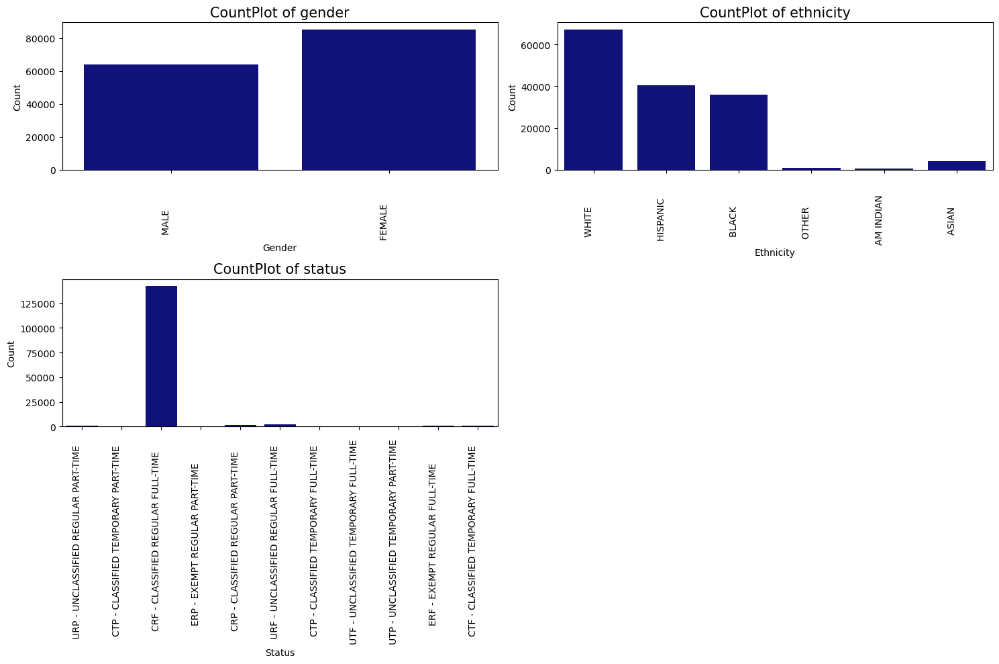

In [27]:
# Countplot for the 'gender' and ethnicity
features = ['gender', 'ethnicity', 'status']
data = df
plt.figure(figsize=(15,10))
i = 1
for feature in features:
    plt.subplot(2, 2, i)
    sns.countplot(x= feature , data=df, color='darkblue')
    plt.xticks(rotation=90, ha='right')
    plt.title(f'CountPlot of {feature}', fontsize=15)
    plt.xlabel(feature.capitalize(), fontsize=10)
    plt.ylabel('Count', fontsize=10)
    i=i+1
plt.tight_layout()
plt.show()

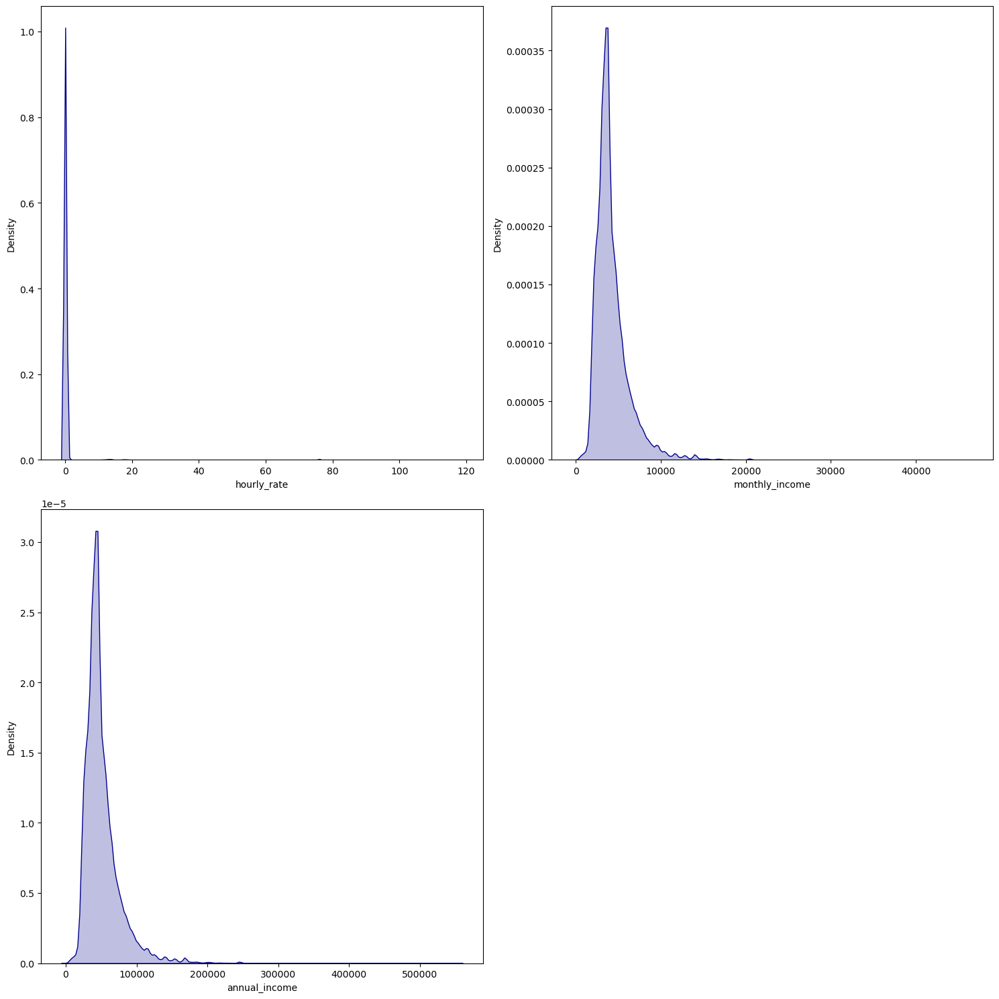

In [28]:
# Checking the distribution of continuous features
conti_var = ['hourly_rate', 'monthly_income', 'annual_income']
data = df
plt.figure(figsize=(15, 15))

i = 1
for var in conti_var:
    plt.subplot(2, 2, i)
    sns.kdeplot(x=var, data=df, color='darkblue', fill = True)
    plt.xlabel(var, fontsize=10)
    i += 1

plt.tight_layout()
plt.show()

### Interpretation(Univariate Analysis):
#### 1) There are 113 different agencies working for the Texas State government.
#####
#### 2) There are 1,422 different posts held by employees in the Texas State government.
#####
#### 3) The number of female employees is greater than the number of male employees working for the Texas State government.
#####
#### 4) The largest number of employees belong to the White ethnicity, which may be because Texas has a larger population of white residents.
#####
#### 5) Most employees have the employment status of CRF (Classified Regular Full-Time), meaning they work full-time, have regular hours, and follow specific rules and regulations.
#####
#### 6) The distribution of "hourly_rate", "monthly_income" and "annual_income" is positively skewed and the distribution.
#####

## iii) Bivariate Analysis

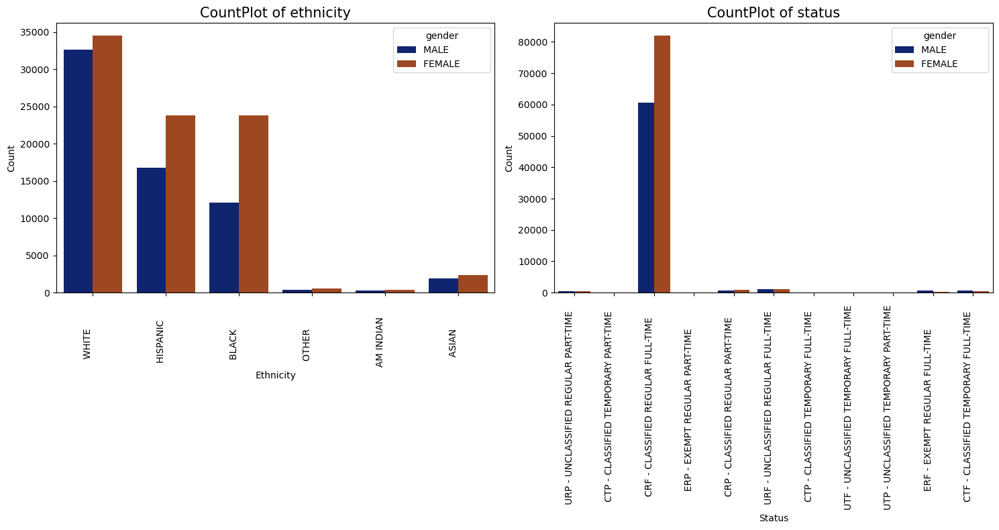

In [31]:
# Countplot for the 'status' and ethnicity based on 'gender'
features = ['ethnicity', 'status']
data = df
plt.figure(figsize=(15,8))
i = 1
for feature in features:
    plt.subplot(1, 2, i)
    sns.countplot(x= feature , data=df, hue= 'gender', palette= 'dark')
    plt.xticks(rotation=90, ha='right')
    plt.title(f'CountPlot of {feature}', fontsize=15)
    plt.xlabel(feature.capitalize(), fontsize=10)
    plt.ylabel('Count', fontsize=10)
    i=i+1
plt.tight_layout()
plt.show()

In [32]:
# We have to convert the categorical data into numeric form by using label encoding for the necessary columns.
from sklearn.preprocessing import LabelEncoder
df_new = df.copy()
# Initializing the LabelEncoder
le = LabelEncoder()
# Columns to encode
columns_to_encode = ['class_code','ethnicity', 'gender', 'status','first_name', 'last_name', 'middle_initial']
# Applying label encoding
for col in columns_to_encode:
    df_new[col] = le.fit_transform(df[col])
df_new.head(2)

,agency,agency_name,last_name,first_name,middle_initial,class_code,class_title,ethnicity,gender,status,employ_date,hourly_rate,hours_per_week,monthly_income,annual_income,state_number
0,241,"COMPTROLLER OF PUBLIC ACCOUNTS, JUDICIARY SECT...",30461,15274,22,1409,"JUDGE, RETIRED ...",5,1,8,02/18/88,75.96150,29.0,9545.82,114549.84,127717
1,212,OFFICE OF COURT ADMINISTRATION ...,30461,15274,22,616,GENERAL COUNSEL IV ...,5,1,4,02/01/15,81.04454,4.0,1404.77,16857.24,127717


#### "We didn't convert the 'agency_name' and 'class_title' into numeric values because each value in these columns has a unique equivalent in the 'agency' and 'class_code' columns. To avoid overlapping and to save time on training models, we excluded those columns."
####

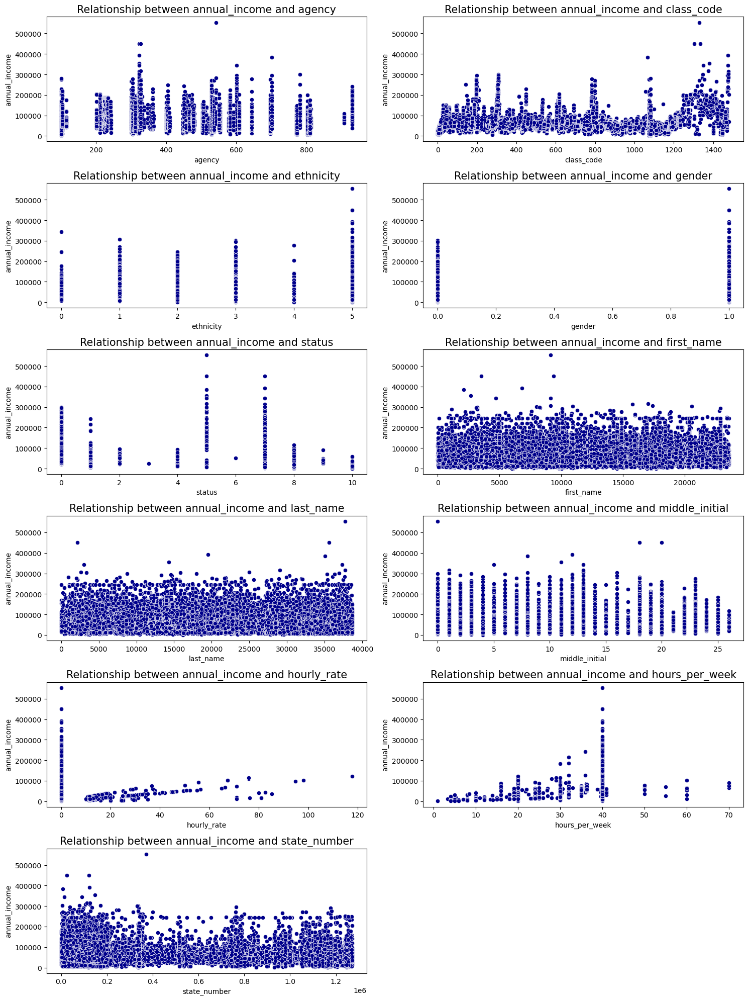

In [34]:
# checking for the relationship between dependent(monthly_income) and independent variables.
ind_var = ['agency', 'class_code', 'ethnicity', 'gender', 'status',
           'first_name', 'last_name', 'middle_initial', 
           'hourly_rate', 'hours_per_week','state_number']
data=df_new
plt.figure(figsize=(15,20))
i=1
for var in ind_var:
    plt.subplot(6, 2, i)
    sns.scatterplot(x=var, y='annual_income', data=df_new, color='darkblue')
    plt.title(f'Relationship between annual_income and {var}', fontsize=15)
    i=i+1
plt.tight_layout()
plt.show()

### Interpretation(Bivariate Analysis):
#### 1) As the overall number of female employees is greater than male employees, the number of female employees in every ethnicity is also greater than males.
#####
#### 2) The number of female employees is higher with classified regular full-time status, but for class exempt regular full-time and classified temporary full-time, male employees are more than female employees.
#####
#### 3) There is no particular relationship between the dependent and independent variables. So, we can't use linear regression, which requires a linear relationship between dependent and independent variables.
#####
#### 4) According to ethnicity, White employees have more annual income than others, around 40,000 dollars, and for some, more than that.
#####
#### 5) It is observed that certain male employees have more annual income than all female employees.
#####
#### 6) Generally, employees with a high hourly rate have high annual income, but it is observed that employees with a low hourly rate have more annual income than others. This may be due to extra hours of working.
#####
#### 7) It is observed that employees having 40 working hours per week have the highest annual income.
#####


## iii) Multivariate Analysis

<Axes: >

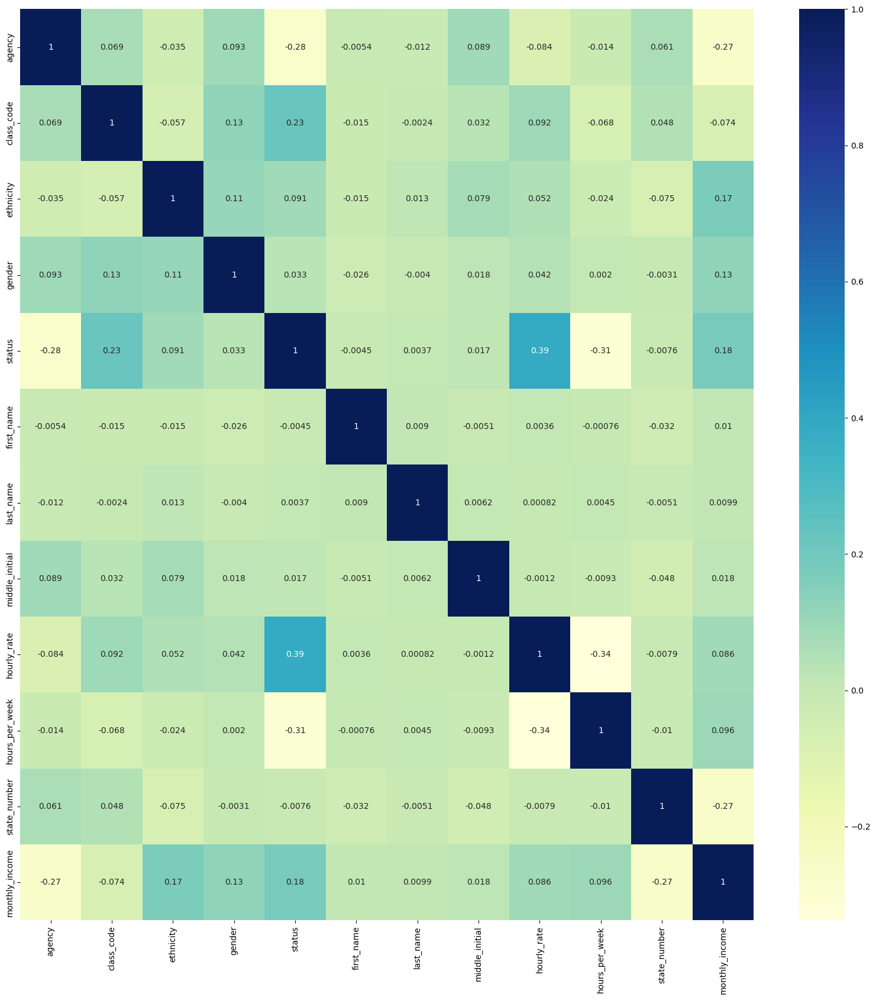

In [37]:
# Corr. Matrix
var = ['agency', 'class_code', 'ethnicity', 'gender', 'status',
           'first_name', 'last_name', 'middle_initial', 
           'hourly_rate', 'hours_per_week','state_number', 'monthly_income']
corr_matrix = df_new[var].corr()
plt.figure(figsize=(20,20))
sns.heatmap(corr_matrix, annot=True, cmap='YlGnBu')

#### There is no multicollinearirty in the selected features.
####

# 3) Data Preprocessing and Feature Engineering

## i) Outliers Handling

<Axes: ylabel='annual_income'>

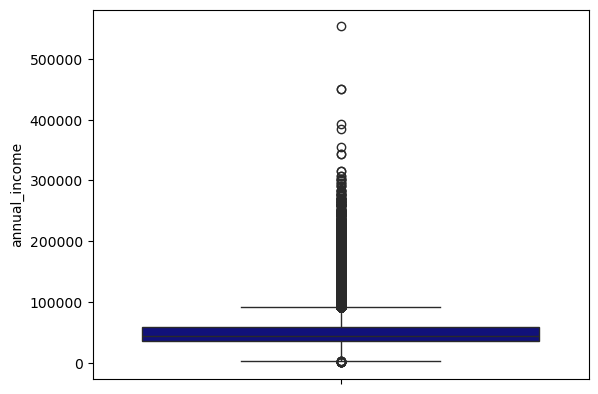

In [41]:
# Checking the outliers for 'annual_income'
sns.boxplot(df_new['annual_income'], color = 'darkblue')

In [42]:
# IQR method to remove outliers
Q1 = df_new['annual_income'].quantile(0.25)
Q3 = df_new['annual_income'].quantile(0.75)
IQR = Q3-Q1
lb_AI = Q1-1.5*IQR
print(lb_AI)
ub_AI = Q3+1.5*IQR
print(ub_AI)

3010.6200000000026
91617.18


#### The upper bound value is 91,617.18 and the lower bound value is 3,010.62, which indicates that all employees who earn more than 91,617.18 dollars annually and less than 3,010 dollars annually are the outliers.
#####

<Axes: ylabel='hourly_rate'>

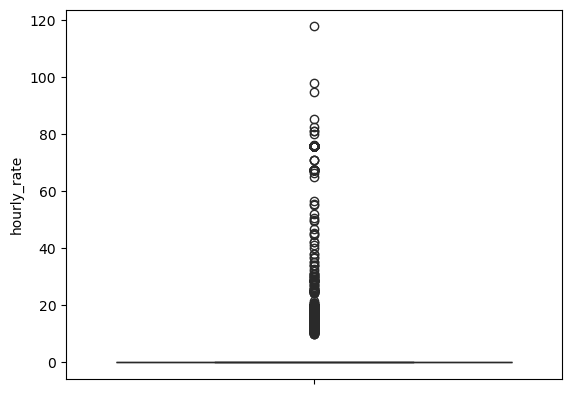

In [44]:
# Checking outliers for hourly_rate
sns.boxplot(df_new['hourly_rate'], color = 'darkblue')

#### The boxplot is showing too many outliers because the data is highly positively skewed and highly concentrated around the value zero. Let's cross-verify this using IQR.
#####

In [46]:
Q1 = df_new['hourly_rate'].quantile(0.25)
Q3 = df_new['hourly_rate'].quantile(0.75)
IQR = Q3-Q1
lb_HR = Q1-1.5*IQR
print(lb_HR)
ub_HR = Q3+1.5*IQR
print(ub_HR)

0.0
0.0


#### The lower and upper bound value of 0 indicates that all values other than zero are outliers, but this may give us a misleading result. 
####

<Axes: ylabel='hours_per_week'>

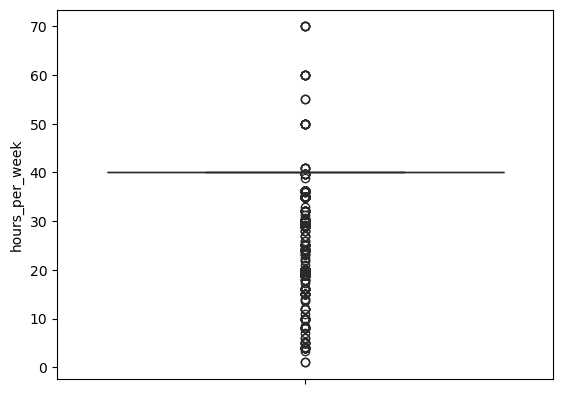

In [48]:
# Checking outliers for hours_per_week.
sns.boxplot(df_new['hours_per_week'], color = 'darkblue')

#### The boxplot is showing too many outliers because the data is highly positively skewed and highly concentrated around the value 40. Let's cross-verify this using IQR.
#####

In [50]:
Q1 = df_new['hours_per_week'].quantile(0.25)
Q3 = df_new['hours_per_week'].quantile(0.75)
IQR = Q3-Q1
lb_HPW = Q1-1.5*IQR
print(lb_HPW)
ub_HPW = Q3+1.5*IQR
print(ub_HPW)

40.0
40.0


#### The lower and upper bound value of 40 indicates that all values other than 40 are outliers, but this may give us a misleading result. 
####

### Interpretation:
#### The outliers observed in the boxplot are natural outliers, so removing them may not be appropriate.
#### We will try to use the regression models that are not sensetive to the outliers.
#####

## ii) feature seletion and transformation

In [54]:
data_new = df_new[['agency', 'class_code', 'ethnicity', 'gender', 'status',
                 'first_name', 'last_name', 'middle_initial', 
                 'hourly_rate', 'hours_per_week', 'state_number', 'annual_income']]
data_new.head()

,agency,class_code,ethnicity,gender,status,first_name,last_name,middle_initial,hourly_rate,hours_per_week,state_number,annual_income
0,241,1409,5,1,8,15274,30461,22,75.96150,29.0,127717,114549.84
1,212,616,5,1,4,15274,30461,22,81.04454,4.0,127717,16857.24
2,241,1409,5,1,8,10053,33197,10,75.96150,29.0,59115,114549.84
3,212,616,5,1,4,10053,33197,10,81.04453,4.0,59115,16857.24
4,696,810,3,0,0,6953,26462,0,0.00000,40.0,165030,39411.24


#### We have to standardize the hourly_rate, hours_per_week, and monthly_income because hourly_rate and annual_income are continuous variables, and hours_per_week is discrete but ordinal. The variables have different scales.
#####
#### Before standardizing these variables, we have to check the distribution of continuous variables. If it is normal, then there is no need for transformation; if not, we should apply a transformation first.
#####
#### The hourly rate is highly positively skewed.( result from univariate analysis).
#####
#### The distribution of 'annual_income' is positively skewed.(result from univariate analysis)
#####


#### We use square root transformation to reduce the skewness of these columns. In such situations, log transformation is more effective, but the feature contains some values of 0.

In [57]:
data_new.loc[: , 'hourly_rate'] = np.sqrt(data_new['hourly_rate'])
data_new.loc[:, 'annual_income'] = np.sqrt(data_new['annual_income'])
data_new.head(2)

,agency,class_code,ethnicity,gender,status,first_name,last_name,middle_initial,hourly_rate,hours_per_week,state_number,annual_income
0,241,1409,5,1,8,15274,30461,22,8.715589,29.0,127717,338.452124
1,212,616,5,1,4,15274,30461,22,9.002474,4.0,127717,129.835434


In [58]:
# Standerdizing the numerical_columns which are either conti. or ordinal
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
num_col = ['hourly_rate', 'hours_per_week', 'annual_income']
data_new.loc[: , num_col] = scaler.fit_transform(data_new[num_col])

In [59]:
data_new.head(1)

,agency,class_code,ethnicity,gender,status,first_name,last_name,middle_initial,hourly_rate,hours_per_week,state_number,annual_income
0,241,1409,5,1,8,15274,30461,22,14.78065,-4.610854,127717,2.432935


## iii) data split

In [61]:
from sklearn.model_selection import train_test_split
X=data_new.iloc[:, : -1]
y=data_new.iloc[:, -1]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 4) Model Implimentation

## i) Decision Tree Regressor

In [64]:
from sklearn.tree import DecisionTreeRegressor
tree_model = DecisionTreeRegressor()
tree_model.fit(X_train, y_train)

DecisionTreeRegressor()

In [65]:
y_predict = tree_model.predict(X_test)

### Model Evaluation:

In [67]:
from sklearn.metrics import mean_squared_error, r2_score
mse_dec_tree = mean_squared_error(y_test, y_predict)
r2_score_dec_tree = r2_score(y_test, y_predict)
print("mean squared error of DT regressor is:", mse_dec_tree)
print("coeff. of determination of DT regressor is:", r2_score_dec_tree )

mean squared error of DT regressor is: 0.11485894531464583
coeff. of determination of DT regressor is: 0.8852947258244402


#### Good Model Performance: The combination of a low MSE and a high R² score suggests that the model is performing well in predicting the target variable.

#### Reliable Predictions: The high R² value indicates that the model reliably captures the underlying patterns in the data, while the low MSE implies that prediction errors are minimal.

## ii) Random Forest Regressor

In [70]:
from sklearn.ensemble import RandomForestRegressor
rf_model = RandomForestRegressor(random_state = 42)
rf_model.fit(X_train, y_train)

RandomForestRegressor(random_state=42)

In [71]:
y_predict_rf = rf_model.predict(X_test)

### Model Evaluation:

In [73]:
from sklearn.metrics import mean_squared_error, r2_score
mse_rf = mean_squared_error(y_test, y_predict_rf)
print("mean squared error of rf model is :", mse_rf)
r2_score_rf = r2_score(y_test, y_predict_rf)
print("coeff. of determination for rf model is :", r2_score_rf )

mean squared error of rf model is : 0.06696869214998354
coeff. of determination for rf model is : 0.9331209060539492


#### Strong Model Performance: The combination of a low MSE and a high R² score indicates that the Random Forest model is performing exceptionally well.

#### Reliable Predictions: The high R² score implies that the features used in the model have strong predictive power, and the low MSE confirms that the prediction errors are minimal.

# 5) Identifying 'who are the outliers ?'

<Axes: ylabel='annual_income'>

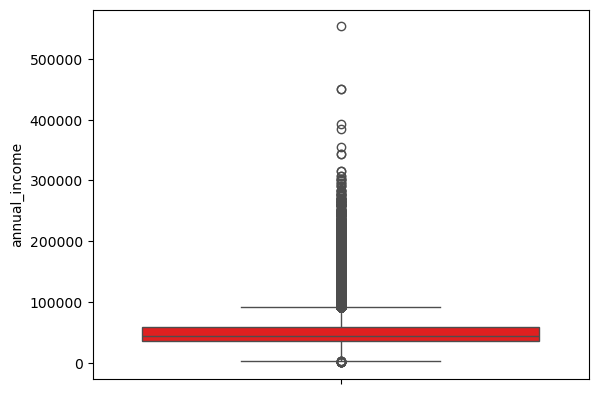

In [76]:
sns.boxplot(df['annual_income'], color = "red")

In [77]:
print(lb_AI)
print(ub_AI)

3010.6200000000026
91617.18


#### As per the IQR method, the annual_income below the lb_AI and above the ub_AI are outliers, but we know that these are natural outliers. However, for the use of the Texas State Government, we will identify the outliers that may be significant and useful.

#### From the box plot, it is observed that the concentration of annual salary is very high up to 300,000, so we consider the entries above that as outliers.

In [80]:
outliers_AI = df[df['annual_income'] > 300000]
pd.set_option('display.max_rows', None)
outliers_AI

,agency,agency_name,last_name,first_name,middle_initial,class_code,class_title,ethnicity,gender,status,employ_date,hourly_rate,hours_per_week,monthly_income,annual_income,state_number
14793,323,TEACHER RETIREMENT SYSTEM ...,AUBY,JASE,R,C204,CHIEF INVESTMENT OFFICER ...,WHITE,MALE,ERF - EXEMPT REGULAR FULL-TIME,11/09/09,0.0,40.0,37500.00,450000.00,121522
14800,323,TEACHER RETIREMENT SYSTEM ...,BALACHANDRAN,RAM,M,U105,SENIOR MANAGING DIRECTOR ...,ASIAN,MALE,URF - UNCLASSIFIED REGULAR FULL-TIME,02/01/08,0.0,40.0,25583.33,306999.96,125360
14814,323,TEACHER RETIREMENT SYSTEM ...,BELL,SYLVIA,P,U105,SENIOR MANAGING DIRECTOR ...,HISPANIC,FEMALE,URF - UNCLASSIFIED REGULAR FULL-TIME,07/01/10,0.0,40.0,25250.00,303000.00,80175
15041,323,TEACHER RETIREMENT SYSTEM ...,GUTHRIE,BRIAN,K,E176,EXECUTIVE DIRECTOR ...,WHITE,MALE,ERF - EXEMPT REGULAR FULL-TIME,10/01/08,0.0,40.0,29595.12,355141.44,147935
15078,323,TEACHER RETIREMENT SYSTEM ...,HOFFMAN,KATHLEEN,H,U105,SENIOR MANAGING DIRECTOR ...,WHITE,FEMALE,URF - UNCLASSIFIED REGULAR FULL-TIME,06/21/04,0.0,40.0,25250.00,303000.00,171322
15154,323,TEACHER RETIREMENT SYSTEM ...,LANG,ERIC,L,U105,SENIOR MANAGING DIRECTOR ...,WHITE,MALE,URF - UNCLASSIFIED REGULAR FULL-TIME,02/01/06,0.0,40.0,32666.66,391999.92,124553
15283,323,TEACHER RETIREMENT SYSTEM ...,NIELD,JAMES,M,U106,MANAGING DIRECTOR ...,WHITE,MALE,URF - UNCLASSIFIED REGULAR FULL-TIME,12/07/09,0.0,40.0,25583.33,306999.96,106082
15349,323,TEACHER RETIREMENT SYSTEM ...,RANDALL,NEIL,A,U106,MANAGING DIRECTOR ...,WHITE,MALE,URF - UNCLASSIFIED REGULAR FULL-TIME,11/01/07,0.0,40.0,26250.00,315000.00,113006
15525,323,TEACHER RETIREMENT SYSTEM ...,WALKER,GRANT,A,U107,SENIOR DIRECTOR ...,WHITE,MALE,URF - UNCLASSIFIED REGULAR FULL-TIME,11/01/07,0.0,40.0,25166.67,302000.04,5508
15539,323,TEACHER RETIREMENT SYSTEM ...,WEST,DALE,E,U105,SENIOR MANAGING DIRECTOR ...,AM INDIAN,MALE,URF - UNCLASSIFIED REGULAR FULL-TIME,02/19/08,0.0,40.0,28666.67,344000.04,14408


#### "These are outliers in the annual income, indicating that the Texas State Government is spending higher than usual on these agencies and their corresponding employees."

<Axes: ylabel='hours_per_week'>

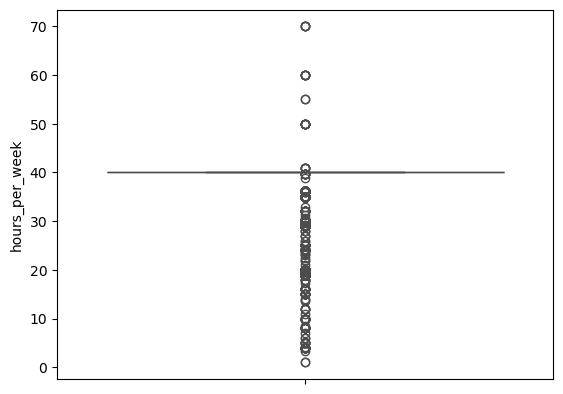

In [82]:
sns.boxplot(df['hours_per_week'], color = "red")

In [83]:
print(lb_HPW)
print(ub_HPW)

40.0
40.0


#### "As per the IQR, the value other than 40 is an outlier, but according to the domain study, the outliers are natural."
#####
#### "As seen in the boxplot, most of the points are concentrated below and around 40. Therefore, for the convenience of the Texas State Government, the points above 40 can be considered outliers. This is because the government must be aware of employee health issues due to overtime work."

In [85]:
outliers_HPW = df[df['hours_per_week'] > 40]
pd.set_option('display.max_rows', None)
outliers_HPW

,agency,agency_name,last_name,first_name,middle_initial,class_code,class_title,ethnicity,gender,status,employ_date,hourly_rate,hours_per_week,monthly_income,annual_income,state_number
37,101,SENATE ...,BELTRAN,AHITZA,G,7103,LEG. SERVICE/MAINTENANCE ...,HISPANIC,FEMALE,URF - UNCLASSIFIED REGULAR FULL-TIME,01/02/19,0.0,41.0,2694.26,32331.12,1164354
53,101,SENATE ...,KENNY,PAT,,7104,LEGISLATIVE PROFESSIONAL ...,WHITE,FEMALE,URF - UNCLASSIFIED REGULAR FULL-TIME,02/03/05,0.0,41.0,4140.18,49682.16,37375
56,101,SENATE ...,MATEER,TIMOTHY,E,7103,LEG. SERVICE/MAINTENANCE ...,WHITE,MALE,URF - UNCLASSIFIED REGULAR FULL-TIME,04/01/03,0.0,41.0,4098.93,49187.16,51668
63,101,SENATE ...,ROCHA,MARIE,S,7103,LEG. SERVICE/MAINTENANCE ...,HISPANIC,FEMALE,URF - UNCLASSIFIED REGULAR FULL-TIME,05/01/03,0.0,41.0,3365.40,40384.80,152257
78,101,SENATE ...,WHITE,MARK,,7103,LEG. SERVICE/MAINTENANCE ...,WHITE,MALE,URF - UNCLASSIFIED REGULAR FULL-TIME,01/23/04,0.0,41.0,5021.45,60257.40,152770
80,102,HOUSE OF REPRESENTATIVES ...,CLINE,GREGORY,S,7110,ELECTED OFFICIALS STAFF ...,WHITE,MALE,URF - UNCLASSIFIED REGULAR FULL-TIME,01/30/19,0.0,50.0,3000.00,36000.00,531649
81,102,HOUSE OF REPRESENTATIVES ...,CROW,KORI,M,7110,ELECTED OFFICIALS STAFF ...,HISPANIC,FEMALE,URF - UNCLASSIFIED REGULAR FULL-TIME,08/31/11,0.0,60.0,922.50,11070.00,194014
82,102,HOUSE OF REPRESENTATIVES ...,DIAZ,DAVID,A,7110,ELECTED OFFICIALS STAFF ...,HISPANIC,MALE,URF - UNCLASSIFIED REGULAR FULL-TIME,03/01/11,0.0,55.0,2280.59,27367.08,182335
83,102,HOUSE OF REPRESENTATIVES ...,DUBBERKE,TAMMY,J,7110,ELECTED OFFICIALS STAFF ...,WHITE,FEMALE,URF - UNCLASSIFIED REGULAR FULL-TIME,08/01/13,0.0,60.0,5437.07,65244.84,152904
84,102,HOUSE OF REPRESENTATIVES ...,DURAND,SAMANTHA,R,7110,ELECTED OFFICIALS STAFF ...,WHITE,FEMALE,URF - UNCLASSIFIED REGULAR FULL-TIME,11/01/19,0.0,50.0,6250.00,75000.00,1055307


<Axes: ylabel='hourly_rate'>

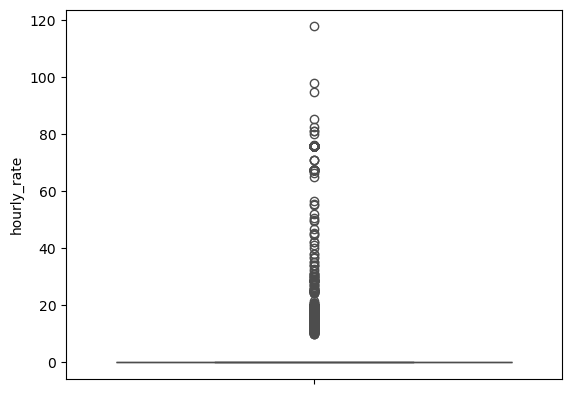

In [86]:
sns.boxplot(df['hourly_rate'], color = "red")

In [87]:
print(lb_HR)
print(ub_HR)

0.0
0.0


#### "As per the IQR method, the values that are not zero are considered outliers, but this does not make any sense."
#####
#### "As seen in the boxplot, the concentration of data is denser up to 80. Therefore, for the convenience of the Texas State Government, it is necessary to identify which employees are earning higher than usual per hour."

In [89]:
outliers_HR = df[df['hourly_rate'] > 80]
pd.set_option('display.max_rows', None)
outliers_HR

,agency,agency_name,last_name,first_name,middle_initial,class_code,class_title,ethnicity,gender,status,employ_date,hourly_rate,hours_per_week,monthly_income,annual_income,state_number
1,212,OFFICE OF COURT ADMINISTRATION ...,RUCKER,MORTON,V,3524,GENERAL COUNSEL IV ...,WHITE,MALE,CTP - CLASSIFIED TEMPORARY PART-TIME,02/01/15,81.04454,4.0,1404.77,16857.24,127717
3,212,OFFICE OF COURT ADMINISTRATION ...,SPECIA JR,JOHN,J,3524,GENERAL COUNSEL IV ...,WHITE,MALE,CTP - CLASSIFIED TEMPORARY PART-TIME,09/01/18,81.04453,4.0,1404.77,16857.24,59115
14901,323,TEACHER RETIREMENT SYSTEM ...,COOK,DAVID,,1624,DIRECTOR V ...,WHITE,MALE,CRP - CLASSIFIED REGULAR PART-TIME,01/14/19,82.63500,10.0,3580.85,42970.20,152498
33247,529,HEALTH AND HUMAN SERVICES COMMISSION ...,BADIGER,MALLIKARJUN,P,4478,PSYCHIATRIST III ...,AM INDIAN,MALE,CRP - CLASSIFIED REGULAR PART-TIME,09/01/17,117.78848,20.0,10208.33,122499.96,352271
40283,529,HEALTH AND HUMAN SERVICES COMMISSION ...,DURAND-HOLLIS,GABRIEL,,4477,PSYCHIATRIST II ...,HISPANIC,MALE,CRP - CLASSIFIED REGULAR PART-TIME,09/01/17,85.16291,8.4,3099.92,37199.04,49898
67758,529,HEALTH AND HUMAN SERVICES COMMISSION ...,YEAGLEY,SUSANNE,C,4438,PHYSICIAN III ...,WHITE,FEMALE,CRP - CLASSIFIED REGULAR PART-TIME,09/01/17,94.73365,20.0,8210.24,98522.88,788178
67778,529,HEALTH AND HUMAN SERVICES COMMISSION ...,YITTA,SUSEELA,,4438,PHYSICIAN III ...,ASIAN,FEMALE,CRP - CLASSIFIED REGULAR PART-TIME,09/01/17,97.95458,20.0,8489.39,101872.68,776784


# 6) Have salaries and total compensations for some roles/ departments/ head-count changed over time?

In [91]:
# Convert 'employ_date' to datetime format with specified format
df['employ_date'] = pd.to_datetime(df['employ_date'], format='%m/%d/%y')
df_sorted = df.sort_values(by='employ_date')
df_sorted.head(10)

,agency,agency_name,last_name,first_name,middle_initial,class_code,class_title,ethnicity,gender,status,employ_date,hourly_rate,hours_per_week,monthly_income,annual_income,state_number
141891,102,HOUSE OF REPRESENTATIVES ...,CRADDICK,TOM,R,7109,ELECTED OFFICIAL ...,WHITE,MALE,URF - UNCLASSIFIED REGULAR FULL-TIME,1969-01-14,0.0000,40.0,600.00,7200.00,116511
116978,696,TEXAS DEPARTMENT OF CRIMINAL JUSTICE ...,JUDD,ARTHUR,G,4675,AGRICULTURE SPEC V ...,WHITE,MALE,CRF - CLASSIFIED REGULAR FULL-TIME,1969-07-14,0.0000,40.0,4033.74,48404.88,68427
20904,405,DEPARTMENT OF PUBLIC SAFETY ...,HARALSON,JOE,W,9940,"SERGEANT, DPS ...",WHITE,MALE,CRF - CLASSIFIED REGULAR FULL-TIME,1971-10-06,0.0000,40.0,7207.91,86494.92,171968
88771,601,TEXAS DEPARTMENT OF TRANSPORTATION ...,HALFORD,JULIA,F,0152,ADMINISTRATIVE ASST II ...,WHITE,FEMALE,CRF - CLASSIFIED REGULAR FULL-TIME,1972-08-01,0.0000,40.0,3388.44,40661.28,100209
142425,102,HOUSE OF REPRESENTATIVES ...,THOMPSON,SENFRONIA,,7109,ELECTED OFFICIAL ...,BLACK,FEMALE,URF - UNCLASSIFIED REGULAR FULL-TIME,1973-01-09,0.0000,40.0,600.00,7200.00,6963
92736,601,TEXAS DEPARTMENT OF TRANSPORTATION ...,OTAHAL,MARY,M,1572,PROGRAM SPECIALIST III ...,WHITE,FEMALE,CRF - CLASSIFIED REGULAR FULL-TIME,1973-09-10,0.0000,40.0,5733.00,68796.00,180353
1825,241,"COMPTROLLER OF PUBLIC ACCOUNTS, JUDICIARY SECT...",KEESHAN JR,JAMES,H,JD25,"JUDGE, RETIRED ...",WHITE,MALE,URP - UNCLASSIFIED REGULAR PART-TIME,1975-09-01,75.9615,29.0,9545.82,114549.84,51448
8236,304,COMPTROLLER OF PUBLIC ACCOUNTS ...,LEWIS,MARGARET,A,1063,TAXPYR COMPLIANCE OFFCR V ...,BLACK,FEMALE,CRF - CLASSIFIED REGULAR FULL-TIME,1976-03-15,0.0000,40.0,5003.02,60036.24,72709
7973,304,COMPTROLLER OF PUBLIC ACCOUNTS ...,HUNTSMAN,KEITH,N,0256,SYSTEMS ANALYST V ...,WHITE,MALE,CRF - CLASSIFIED REGULAR FULL-TIME,1976-06-14,0.0000,40.0,6229.00,74748.00,50876
8155,304,COMPTROLLER OF PUBLIC ACCOUNTS ...,KOCH,KENNETH,G,1068,TAX ANALYST IV ...,WHITE,MALE,CRF - CLASSIFIED REGULAR FULL-TIME,1976-07-05,0.0000,40.0,7627.41,91528.92,46678


In [92]:
# Converting 'employ_date' to datetime format
df['employ_date'] = pd.to_datetime(df['employ_date'])
# Extracting year from 'employ_date'
df['year'] = df['employ_date'].dt.year
unique_years_counts = df['employ_date'].dt.year.value_counts()
print(unique_years_counts)

employ_date
2019    22017
2017    20447
2018    15940
2020    14557
2016    11387
2015     7107
2014     6328
2013     6006
2012     4831
2008     3907
2004     3548
2009     3513
2011     3455
2007     3356
2010     2963
2006     2878
2005     2665
2002     1682
2000     1629
2001     1598
2003     1468
1999     1341
1998     1210
1997      960
1996      918
1995      774
1994      725
1993      523
1992      511
1990      216
1991      203
1989      199
1987      138
1988      129
1985       84
1986       77
1984       53
1983       41
1981       29
1982       21
1979       12
1980       10
1977        7
1976        5
1978        5
1973        2
1969        2
1975        1
1971        1
1972        1
2068        1
Name: count, dtype: int64


In [93]:
# We drop the years which are the true outliers.
years_to_drop = [2068, 2069, 2071, 2072, 2073]
filtered_df = df[~df['year'].isin(years_to_drop)]

In [94]:
# Calculating average salary per year
max_salary_per_year = filtered_df.groupby('year')['annual_income'].max().reset_index()
print(max_salary_per_year)

    year  annual_income
0   1969       48404.88
1   1971       86494.92
2   1972       40661.28
3   1973       68796.00
4   1975      114549.84
5   1976      114549.84
6   1977      114549.84
7   1978      168000.00
8   1979      199366.56
9   1980      182201.04
10  1981      133144.68
11  1982      197333.88
12  1983      294000.00
13  1984      228774.96
14  1985      237000.00
15  1986      207107.04
16  1987      198164.04
17  1988      237927.96
18  1989      343999.92
19  1990      220000.08
20  1991      275500.92
21  1992      276815.88
22  1993      229092.00
23  1994      295640.40
24  1995      265000.08
25  1996      198164.04
26  1997      249999.96
27  1998      260946.12
28  1999      282353.28
29  2000      384375.00
30  2001      254225.52
31  2002      284850.00
32  2003      201000.00
33  2004      303000.00
34  2005      228774.96
35  2006      391999.92
36  2007      315000.00
37  2008      355141.44
38  2009      450000.00
39  2010      303000.00
40  2011      23

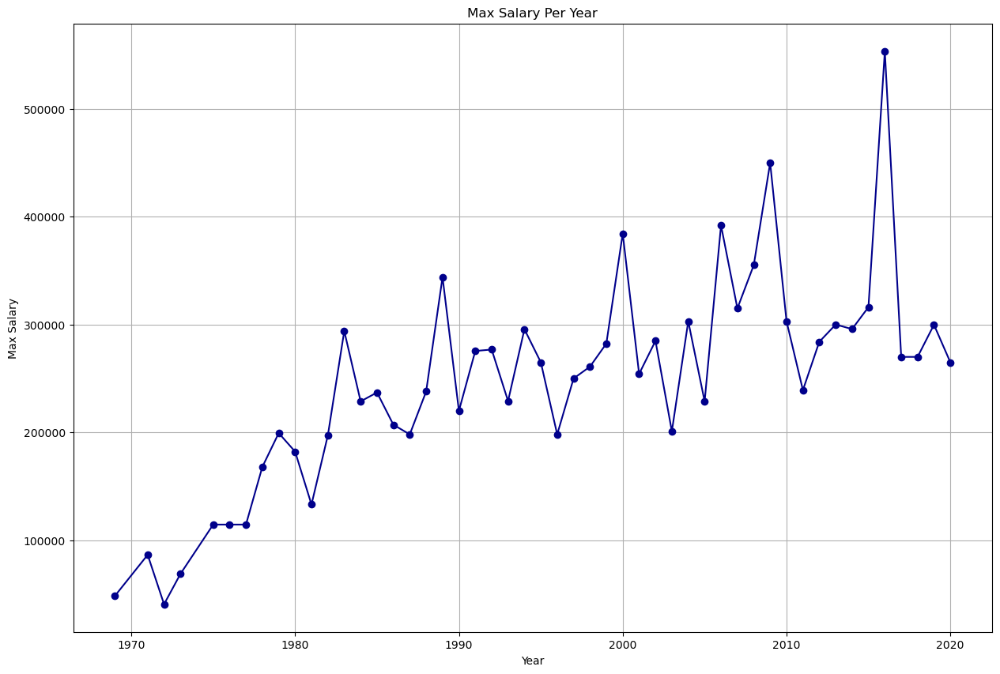

In [95]:
# Plotting the average salary per year
plt.figure(figsize=(15, 10))
plt.plot(max_salary_per_year['year'], max_salary_per_year['annual_income'], marker='o', linestyle='-', color='darkblue')
plt.title('Max Salary Per Year')
plt.xlabel('Year')
plt.ylabel('Max Salary')
plt.grid(True)
plt.show()


### Interpretation :
#### "As we can see, the maximum salary is increasing year by year."

In [97]:
data1=df[['agency_name','class_title','annual_income','employ_date']]
data1.head()

,agency_name,class_title,annual_income,employ_date
0,"COMPTROLLER OF PUBLIC ACCOUNTS, JUDICIARY SECT...","JUDGE, RETIRED ...",114549.84,1988-02-18
1,OFFICE OF COURT ADMINISTRATION ...,GENERAL COUNSEL IV ...,16857.24,2015-02-01
2,"COMPTROLLER OF PUBLIC ACCOUNTS, JUDICIARY SECT...","JUDGE, RETIRED ...",114549.84,2020-02-01
3,OFFICE OF COURT ADMINISTRATION ...,GENERAL COUNSEL IV ...,16857.24,2018-09-01
4,TEXAS DEPARTMENT OF CRIMINAL JUSTICE ...,CORREC OFFICER IV ...,39411.24,2020-06-29


In [98]:
df_1 = data1.groupby(['agency_name', 'class_title', 'employ_date']).first().reset_index()
df_1.to_csv('output.csv', index=False)

In [99]:
output_df = pd.read_csv('output.csv')
output_df

,agency_name,class_title,employ_date,annual_income
0,ALCOHOLIC BEVERAGE COMMISSION ...,ACCOUNTANT I ...,2015-04-01,39790.56
1,ALCOHOLIC BEVERAGE COMMISSION ...,ACCOUNTANT I ...,2019-05-01,39000.00
2,ALCOHOLIC BEVERAGE COMMISSION ...,ACCOUNTANT I ...,2019-12-02,39000.00
3,ALCOHOLIC BEVERAGE COMMISSION ...,ACCOUNTANT II ...,2015-10-26,42500.04
4,ALCOHOLIC BEVERAGE COMMISSION ...,ACCOUNTANT IV ...,2015-04-01,48240.00
5,ALCOHOLIC BEVERAGE COMMISSION ...,ACCOUNTANT IV ...,2018-06-01,53760.00
6,ALCOHOLIC BEVERAGE COMMISSION ...,ACCOUNTANT VI ...,2014-05-01,63586.92
7,ALCOHOLIC BEVERAGE COMMISSION ...,ACCOUNTANT VI ...,2018-01-02,63500.04
8,ALCOHOLIC BEVERAGE COMMISSION ...,ACCTS EXAM I ...,2019-07-08,36000.00
9,ALCOHOLIC BEVERAGE COMMISSION ...,ACCTS EXAM III ...,2017-12-01,41000.40


### Interpretation:
#### "Yes, for a few class titles with respect to agency names, the salaries have changed over time; however, for some, the salaries haven't changed."

# 7) What departments/roles have the biggest wage disparities between managers and employees?

In [102]:
df['annual_income'].max()

553500.0

In [103]:
max_salary =  df.loc[data['annual_income'] == 553500]
max_salary

,agency,agency_name,last_name,first_name,middle_initial,class_code,class_title,ethnicity,gender,status,employ_date,hourly_rate,hours_per_week,monthly_income,annual_income,state_number,year
83851,542,CANCER PREVENTION AND RESEARCH INSTITUTE OF TE...,WILLSON,JAMES,,C542,CHIEF SCIENTIFIC OFFICER ...,WHITE,MALE,ERF - EXEMPT REGULAR FULL-TIME,2016-03-01,0.0,40.0,46125.0,553500.0,372291,2016


In [104]:
df['annual_income'].min()

600.0

In [105]:
min_salary =  df.loc[data['annual_income'] == 600]
min_salary

,agency,agency_name,last_name,first_name,middle_initial,class_code,class_title,ethnicity,gender,status,employ_date,hourly_rate,hours_per_week,monthly_income,annual_income,state_number,year
142067,102,HOUSE OF REPRESENTATIVES ...,HOUSTON,DONTE,D,7110,ELECTED OFFICIALS STAFF ...,BLACK,MALE,URP - UNCLASSIFIED REGULAR PART-TIME,2020-05-01,0.0,10.0,50.0,600.0,851628,2020


### Interpretation:
#### CANCER PREVENTION AND RESEARCH INSTITUTE OF TEXAS department is paying highest salary of 553500.0 to CHIEF SCIENTIFIC OFFICER.
####
#### HOUSE OF REPRESENTATIVES department is paying lowest salary of 600.0 to ELECTED OFFICIALS STAFF.
####

# 8) Model Comparison Report

In [108]:
print("mean squared error of DT regressor is:", mse_dec_tree)
print("coeff. of determination of DT regressor is:", r2_score_dec_tree )
print("mean squared error of rf model is :", mse_rf)
print("coeff. of determination for rf model is :", r2_score_rf )

mean squared error of DT regressor is: 0.11485894531464583
coeff. of determination of DT regressor is: 0.8852947258244402
mean squared error of rf model is : 0.06696869214998354
coeff. of determination for rf model is : 0.9331209060539492


#### It is clearly observed that the mean squared error (MSE) for the 'Random Forest Regressor' is lower than that of the 'Decision Tree Regressor', and the R² score is higher for the 'Random Forest Regressor' than the 'Decision Tree Regressor'. Therefore, the best model is the 'Random Forest Regressor'.
####
#### The 'Linear Regression Model' is not applicable for this dataset because there is no linear relationship between the dependent and independent variable.
####
#### The Support Vector Regression (SVR) model was also attempted, but due to the higher skewness in the data leading to more outliers, its performance was very low, and it required more time.
####
#### So for this dataset the best model is 'Random Forest Regressor'.
####

# 9) Challenges Faced

### 1) Dataset Quality :
#### The dataset contains unnecessary columns like 'duplicated', 'summed_annual_salary', 'hide_from_search', 'combined_multiple_jobs', and 'multiple_full_time_jobs', which contain mostly NaN values.
#### 
### 2) Non_Linear Relationship:
#### There is no linear relationship between the dependent and independent variables, so we can't use the linear regression model for prediction.
####
### 3) Time Consuming :
#### The dataset is complex, requiring more time to understand and select appropriate models.